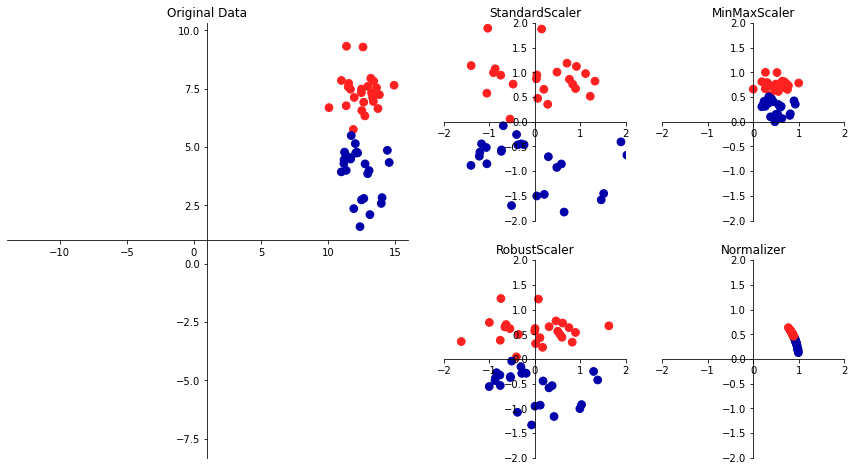

In [1]:
import mglearn

mglearn.plots.plot_scaling()

各前処理の説明はP.129

In [2]:
# cancer / SVMを使ってデータ変換
from sklearn.datasets import load_breast_cancer
from sklearn.model_selection import train_test_split

cancer = load_breast_cancer()
X_train, X_test, y_train, y_test = train_test_split(cancer.data, cancer.target, random_state=1)
print(X_train.shape)
print(X_test.shape)

(426, 30)
(143, 30)


In [3]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

In [4]:
# fit メソッドは訓練データ中の各特徴量の最小値と最大値を計算する
scaler.fit(X_train)

MinMaxScaler()

In [5]:
# データ変換
X_train_scaled = scaler.transform(X_train)
# スケール変換前後のデータ特性をプリント
print("Transformed shape: {}".format(X_train_scaled.shape))
# 各列ごとの最小・最大値
print("per-feature minimum befor scaling:\n{}".format(X_train.min(axis=0)))
print("per-feature maximum befor scaling:\n{}".format(X_train.max(axis=0)))

print("per-feature minimum after scaling:\n{}".format(X_train_scaled.min(axis=0)))
print("per-feature maximum after scaling:\n{}".format(X_train_scaled.max(axis=0)))

Transformed shape: (426, 30)
per-feature minimum befor scaling:
[6.981e+00 9.710e+00 4.379e+01 1.435e+02 5.263e-02 1.938e-02 0.000e+00
 0.000e+00 1.060e-01 5.024e-02 1.153e-01 3.602e-01 7.570e-01 6.802e+00
 1.713e-03 2.252e-03 0.000e+00 0.000e+00 9.539e-03 8.948e-04 7.930e+00
 1.202e+01 5.041e+01 1.852e+02 7.117e-02 2.729e-02 0.000e+00 0.000e+00
 1.566e-01 5.521e-02]
per-feature maximum befor scaling:
[2.811e+01 3.928e+01 1.885e+02 2.501e+03 1.634e-01 2.867e-01 4.268e-01
 2.012e-01 3.040e-01 9.575e-02 2.873e+00 4.885e+00 2.198e+01 5.422e+02
 3.113e-02 1.354e-01 3.960e-01 5.279e-02 6.146e-02 2.984e-02 3.604e+01
 4.954e+01 2.512e+02 4.254e+03 2.226e-01 9.379e-01 1.170e+00 2.910e-01
 5.774e-01 1.486e-01]
per-feature minimum after scaling:
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
per-feature maximum after scaling:
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1.]


In [6]:
# テストセットにも変換を適用する。
X_test_scaled = scaler.transform(X_test)
# スケール変換前後のデータ特性をプリント
print("per-feature minimum after scaling:\n{}".format(X_test_scaled.min(axis=0)))
print("per-feature maximum after scaling:\n{}".format(X_test_scaled.max(axis=0)))

# transformメソッドは常に訓練データの最小値を引き、訓練データのレンジで割る。テストセットの最小値やレンジとは違うものがあるため、0~1以外の数値が出てくる

per-feature minimum after scaling:
[ 0.0336031   0.0226581   0.03144219  0.01141039  0.14128374  0.04406704
  0.          0.          0.1540404  -0.00615249 -0.00137796  0.00594501
  0.00430665  0.00079567  0.03919502  0.0112206   0.          0.
 -0.03191387  0.00664013  0.02660975  0.05810235  0.02031974  0.00943767
  0.1094235   0.02637792  0.          0.         -0.00023764 -0.00182032]
per-feature maximum after scaling:
[0.9578778  0.81501522 0.95577362 0.89353128 0.81132075 1.21958701
 0.87956888 0.9333996  0.93232323 1.0371347  0.42669616 0.49765736
 0.44117231 0.28371044 0.48703131 0.73863671 0.76717172 0.62928585
 1.33685792 0.39057253 0.89612238 0.79317697 0.84859804 0.74488793
 0.9154725  1.13188961 1.07008547 0.92371134 1.20532319 1.63068851]


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

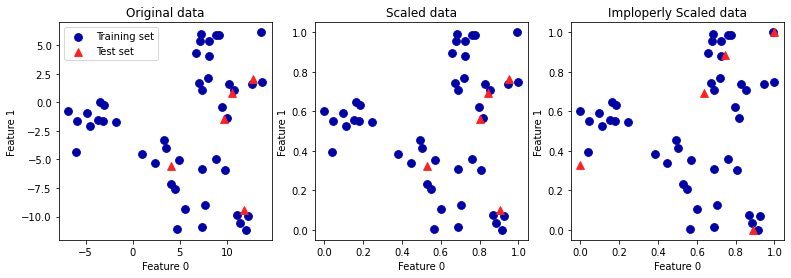

In [7]:
# テストセットを訓練セットと同じように変換することが重要。テストセットの最小値とレンジを使うと何が起こるか？

from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt

# 合成データ生成
X, _ = make_blobs(n_samples=50, centers=5, random_state=4, cluster_std=2)
X_train, X_test = train_test_split(X, random_state=5, test_size=.1)

# 訓練セットとテストセットをプロット
fix, axes = plt.subplots(1, 3, figsize=(13, 4))
axes[0].scatter(X_train[:, 0], X_train[:, 1], c=mglearn.cm2(0), label="Training set", s=60)
axes[0].scatter(X_test[:, 0], X_test[:, 1], marker='^', c=mglearn.cm2(1), label="Test set", s=60)
axes[0].legend(loc='upper left')
axes[0].set_title("Original data")

# MinMaxScalerでスケール変換
scaler = MinMaxScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

axes[1].scatter(X_train_scaled[:, 0], X_train_scaled[:, 1], c=mglearn.cm2(0), label="Training set", s=60)
axes[1].scatter(X_test_scaled[:, 0], X_test_scaled[:, 1], marker='^', c=mglearn.cm2(1), label="Test set", s=60)
axes[1].set_title("Scaled data")

# テストセットを訓練セットとは別にスケール変換
# 最小値・最大値が0,1になる。ここではわざとやっている
# **実際にやってはいけない！！！**
test_scaler = MinMaxScaler().fit(X_test)
X_test_scaled_badly = test_scaler.transform(X_test)

axes[2].scatter(X_train_scaled[:, 0], X_train_scaled[:, 1], c=mglearn.cm2(0), label="Training set", s=60)
axes[2].scatter(X_test_scaled_badly[:, 0], X_test_scaled_badly[:, 1], marker='^', c=mglearn.cm2(1), label="Test set", s=60)
axes[2].set_title("Imploperly Scaled data")

for ax in axes:
    ax.set_xlabel("Feature 0")
    ax.set_ylabel("Feature 1")

In [8]:
# fit を呼び出してから transformを使いたい時は、fit_transformメソッドを使うと効率的に計算できる。
# cancerdatasetでSVCの学習に対するMinMaxScalerの効果をみる
# 元のデータに対して再びSVCを訓練する
from sklearn.svm import SVC

X_train, X_test, y_train, y_test = train_test_split(cancer.data, cancer.target, random_state=0)
svm = SVC(C=1000, gamma=1/cancer.data.shape[1])
svm.fit(X_train, y_train)
print("Test set accuracy: {:.2f}".format(svm.score(X_test, y_test)))

Test set accuracy: 0.63


In [9]:
# スケールを変換して訓練 0-1スケールで
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

svm.fit(X_train_scaled, y_train)
print("Test set accuracy: {:.2f}".format(svm.score(X_test_scaled, y_test)))

Test set accuracy: 0.97


In [10]:
# 平均0 分散1に前処理
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

svm.fit(X_train_scaled, y_train)
print("Test set accuracy: {:.2f}".format(svm.score(X_test_scaled, y_test)))

Test set accuracy: 0.96


教師なし学習を用いたデータ変換の動機は、可視化・データ圧縮・以降の処理に適した表現の発見がある。
これらの目的に対して最もよく用いられるアルゴリズムが、**主成分分析(principal component analysis: PCA)**。
このほかに、あと2つ見ていく。特徴量抽出に用いられる**非負値行列因子分解(non-negative matrix factorization: NMF)**と、2次元散布図を用いたデータの可視化によく用いられる**t-NSE**

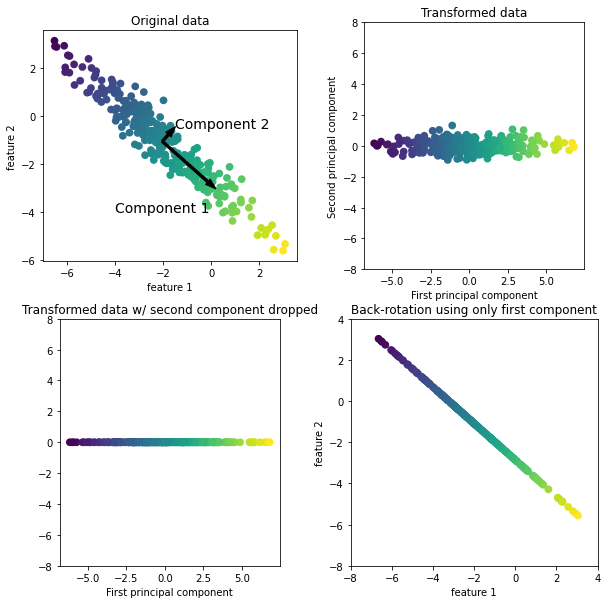

In [11]:
# 主成分分析
mglearn.plots.plot_pca_illustration()
# 詳しくはP.138へ

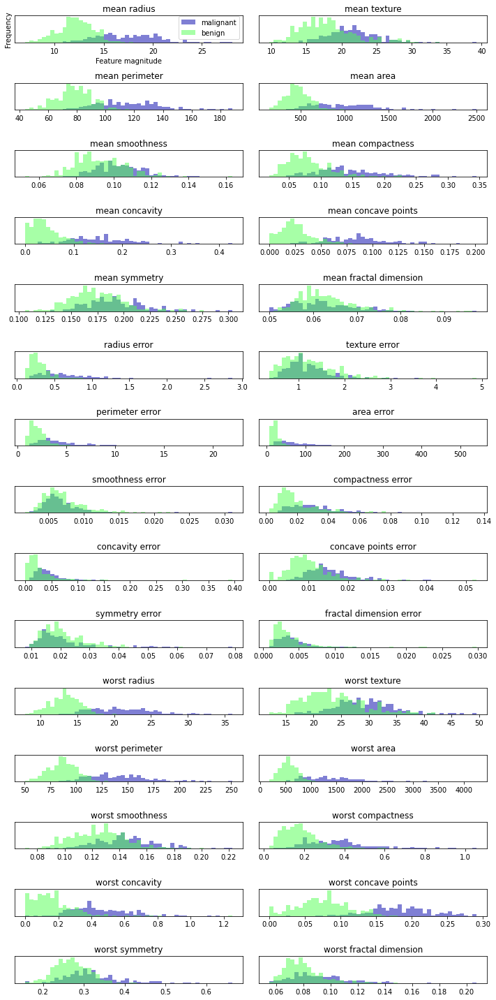

In [12]:
# cancerデートセットのPCAによる可視化
# の前に特徴量ごとに2つのクラスのヒストグラムをかく malignat: 悪性, benign: 良性

import numpy as np

fig, axes = plt.subplots(15, 2, figsize=(10, 20))
malignant = cancer.data[cancer.target == 0]
benign = cancer.data[cancer.target == 1]

ax = axes.ravel()
for i in range(30):
    _, bins = np.histogram(cancer.data[:, i], bins=50)
    ax[i].hist(malignant[:, i], bins=bins, color=mglearn.cm3(0), alpha=.5)
    ax[i].hist(benign[:, i], bins=bins, color=mglearn.cm3(2), alpha=.5)
    ax[i].set_title(cancer.feature_names[i])
    ax[i].set_yticks(())
ax[0].set_xlabel("Feature magnitude")
ax[0].set_ylabel("Frequency")
ax[0].legend(["malignant", "benign"], loc="best")
fig.tight_layout()

# np.histogram: https://deepage.net/features/numpy-histogram.html

In [13]:
# 最初の二つの主成分を用いて２次元空間上の散布図として見てみる

from sklearn.datasets import load_breast_cancer
cancer = load_breast_cancer()

scaler = StandardScaler()
scaler.fit(cancer.data)
X_scaled = scaler.transform(cancer.data)

In [14]:
# 実際にPCA変換を行う
# fit メソッドで主成分を見つけてtransformで回転と次元削減を行う。データの次元削減を行うには、オブジェクトを生成する時に維持する主成分の数を指定する

from sklearn.decomposition import PCA
# 最初の2つの主成分だけ維持
pca = PCA(n_components=2)
# 2つのでデータセットにPCAモデルを適合
pca.fit(X_scaled)

# 2つの主成分に対してデータポイントを変換
X_pca = pca.transform(X_scaled)
print("Original shape: {}".format(X_scaled.shape))
print("Reduced shape: {}".format(X_pca.shape))

Original shape: (569, 30)
Reduced shape: (569, 2)


Text(0, 0.5, 'Second principal compornent')

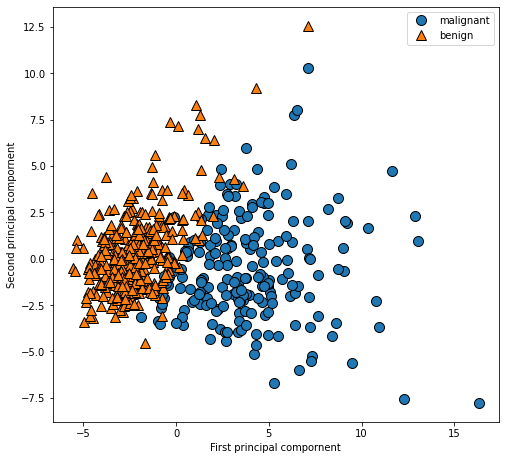

In [15]:
# プロット
plt.figure(figsize=(8, 8))
mglearn.discrete_scatter(X_pca[:, 0], X_pca[:, 1], cancer.target)
plt.legend(cancer.target_names, loc='best')
plt.gca().set_aspect("equal")
plt.xlabel("First principal compornent")
plt.ylabel("Second principal compornent")

# プロットした2つの軸の解釈が容易ではない。

In [16]:
# 2つの主成分の組み合わせは非常に複雑。主成分はPCAの適合を行う過程で、components_属性に格納される

print("PCA component shape: {}".format(pca.components_.shape))
# 各行が主成分に対応し、重要度によってソートされている、列は元の特徴量に対応

PCA component shape: (2, 30)


In [17]:
print("PCA components:\n{}".format(pca.components_))

PCA components:
[[ 0.21890244  0.10372458  0.22753729  0.22099499  0.14258969  0.23928535
   0.25840048  0.26085376  0.13816696  0.06436335  0.20597878  0.01742803
   0.21132592  0.20286964  0.01453145  0.17039345  0.15358979  0.1834174
   0.04249842  0.10256832  0.22799663  0.10446933  0.23663968  0.22487053
   0.12795256  0.21009588  0.22876753  0.25088597  0.12290456  0.13178394]
 [-0.23385713 -0.05970609 -0.21518136 -0.23107671  0.18611302  0.15189161
   0.06016536 -0.0347675   0.19034877  0.36657547 -0.10555215  0.08997968
  -0.08945723 -0.15229263  0.20443045  0.2327159   0.19720728  0.13032156
   0.183848    0.28009203 -0.21986638 -0.0454673  -0.19987843 -0.21935186
   0.17230435  0.14359317  0.09796411 -0.00825724  0.14188335  0.27533947]]


Text(0, 0.5, 'Principal components')

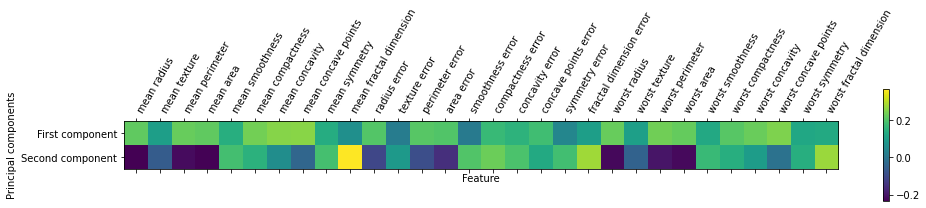

In [18]:
# 係数をヒートマップで見てみる
plt.matshow(pca.components_, cmap='viridis')
plt.yticks([0, 1], ["First component", "Second component"])
plt.colorbar()
plt.xticks(range(len(cancer.feature_names)), cancer.feature_names, rotation=60, ha='left')
plt.xlabel("Feature")
plt.ylabel("Principal components")
# 第一主成分をみると、全ての特徴量が同じ符号→全ての特徴量に一般的な相関がある。ある特徴量が大きければ、他の特徴量も大きくなっている。
# 第二主成分をみると、符号が入り混じっている。また、両方とも30の特徴量が混じっているため、この軸の意味を説明するのは難しい。

PCAの利用方法は、次元削減のほかにも特徴量抽出がある。元のデータの表現よりも、解析に適した表現があり、それを見つけることが可能。
特徴量抽出には画像関連があげられる。

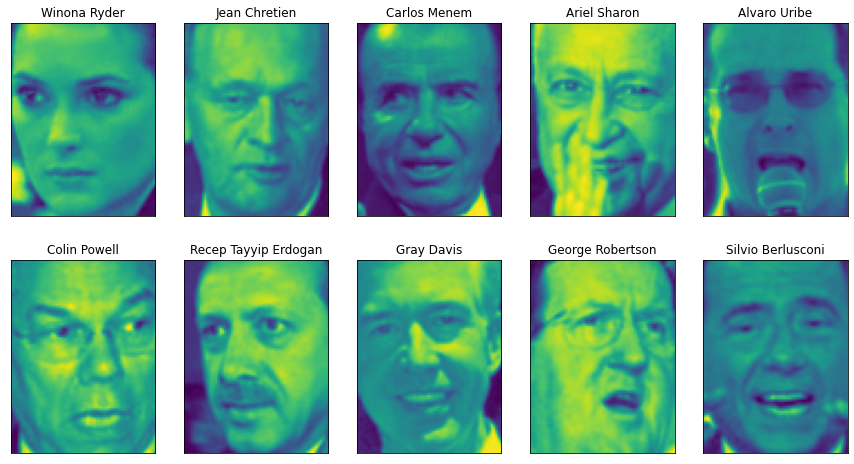

In [19]:
# Labeled Face in the Wildデータセットの顔画像を出す
from sklearn.datasets import fetch_lfw_people

people = fetch_lfw_people(min_faces_per_person=20, resize=.7)
image_shape = people.images[0].shape

fix, axes = plt.subplots(2, 5, figsize=(15, 8), subplot_kw={"xticks": (), "yticks": ()})
for target, image, ax in zip(people.target, people.images, axes.ravel()):
    ax.imshow(image)
    ax.set_title(people.target_names[target])

In [20]:
# 62人分で合わせて3023枚の画像がある。サイズは87✖️65ピクセル
print("people.images.shape: {}".format(people.images.shape))
print("Number of classes: {}".format(len(people.target_names)))

people.images.shape: (3023, 87, 65)
Number of classes: 62


In [21]:
# このデータセットは偏っていて、ジョージWブッシュとコリンバウエルの画像が多い
# 各ターゲットの出現回数をカウント
counts = np.bincount(people.target)
# 各ターゲット名と出現回数をカウント
for i, (count, name) in enumerate(zip(counts, people.target_names)):
    print("{0:25} {1:3}".format(name, count), end='     ')
    if (i + 1) % 3 == 0:
        print()

Alejandro Toledo           39     Alvaro Uribe               35     Amelie Mauresmo            21     
Andre Agassi               36     Angelina Jolie             20     Ariel Sharon               77     
Arnold Schwarzenegger      42     Atal Bihari Vajpayee       24     Bill Clinton               29     
Carlos Menem               21     Colin Powell              236     David Beckham              31     
Donald Rumsfeld           121     George Robertson           22     George W Bush             530     
Gerhard Schroeder         109     Gloria Macapagal Arroyo    44     Gray Davis                 26     
Guillermo Coria            30     Hamid Karzai               22     Hans Blix                  39     
Hugo Chavez                71     Igor Ivanov                20     Jack Straw                 28     
Jacques Chirac             52     Jean Chretien              55     Jennifer Aniston           21     
Jennifer Capriati          42     Jennifer Lopez             21     Jerem

In [22]:
np.bincount([0, 1, 1, 5])

array([1, 2, 0, 0, 0, 1])

In [23]:
# 偏りを減らすために、各人の画像を50に制限する
# target(3023)分のFalse の配列
mask = np.zeros(people.target.shape, dtype=np.bool)
# uniqueで62人分に絞る(0-62までの配列作成)
for target in np.unique(people.target):
    # people.target が target と同じ数値になるインデックスを取得。([],)の形から()をとるために[0]を指定した後、[:50]で50枚目まで取り出す
    # maskの対応したインデックスにTrueを割り当てる
    mask[np.where(people.target == target)[0][:50]] = 1

X_people = people.data[mask]
y_people = people.target[mask]

# 0-255のグレースケールの値を0-1に変換
X_people = X_people / 255

In [24]:
np.unique(people.target)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61])

In [25]:
np.where(people.target == 3)

(array([  27,  237,  388,  449,  461,  612,  623,  676,  738,  770, 1106,
        1132, 1187, 1270, 1273, 1280, 1710, 1714, 1752, 1942, 2056, 2074,
        2160, 2176, 2206, 2216, 2255, 2527, 2601, 2608, 2675, 2738, 2742,
        2801, 2876, 3010]),)

In [26]:
# maskのこれに対応するインデックスをTrueにしている
np.where(people.target == 3)[0][:5]

array([ 27, 237, 388, 449, 461])

In [27]:
# 顔認証にはクラス分類器を作成することとなる。多くの場合、顔データベースにはたくさんの人物が登録されていて同じ人物の画像は少ない。
# このような場合には1-最近傍法クラス分類器を使う方法がある。サンプルが一つあれば十分
from sklearn.neighbors import KNeighborsClassifier

X_train, X_test, y_train, y_test = train_test_split(X_people, y_people, stratify=y_people, random_state=0)
knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(X_train, y_train)
print("Test set score of 1-nn: {:.2f}".format(knn.score(X_test, y_test)))
# 精度はランダムで選ぶよりも悪くないが、よくもない

Test set score of 1-nn: 0.23


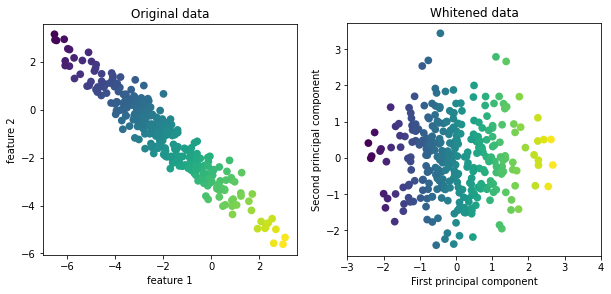

In [28]:
# ピクセルで距離を量っていると、1ピクセル顔をみぎにずらすファ家で表現が全く変わってしまう。ピクセル表現は比較には全く合わない。
# PCAを用いて主成分に沿った距離を使って精度をあげてみる
# whitenオプションを使うことで主成分が同じスケールになるようにスケール変換される。PCA→StandardScalerのセットみたいなの
# 回転させた後に横にも縦にもいい感じにスケールを変えて円状にしてる
mglearn.plots.plot_pca_whitening()

In [29]:
# PCAオブジェクトを訓練 100主成分抜き出す
pca = PCA(n_components=100, whiten=True, random_state=0).fit(X_train)
X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)

print("X_train_pca.shape: {}".format(X_train_pca.shape))
# 新しいデータは100の特徴量(主成分)をもつ。 5655px分の特徴量から100に圧縮できた。

X_train_pca.shape: (1547, 100)


In [30]:
# 新しいデータを使ってknn
knn = KNeighborsClassifier(n_neighbors=1).fit(X_train_pca, y_train)
print("Test set accuracy: {:.2f}".format(knn.score(X_test_pca, y_test)))

Test set accuracy: 0.31


In [31]:
# 主成分の可視化 100の特徴量にはそれぞれ87px*65px=5655分の定数が設定されている
print("pca.components_.shape: {}".format(pca.components_.shape))

pca.components_.shape: (100, 5655)


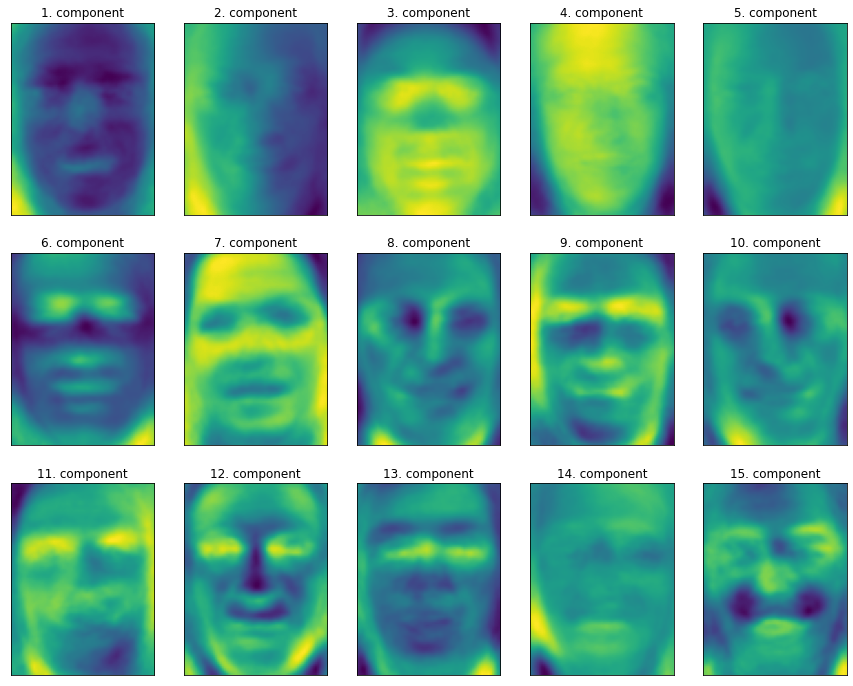

In [32]:
fix, axes = plt.subplots(3, 5, figsize=(15, 12), subplot_kw={'xticks': (), 'yticks': ()})
for i, (component, ax) in enumerate(zip(pca.components_, axes.ravel())):
    # image_shape=> (87, 65): 87*65の画像として出力 
    ax.imshow(component.reshape(image_shape), cmap='viridis')
    ax.set_title("{}. component".format(i + 1))

# いくつかのPCA変換を行った顔画像が何を捉えているかはいくつか推測できる
# 一つ目の主成分は、顔と背景のコントラストを捉えている
# 二つ目は、光の当たり方による顔の左右の明るさを捉えている
# ピク列で表現された画像の差では、顔のパーツや光の当たり具合が強い影響を与えている→人間が顔が似ているか判断する時は、それらはあまり重視されてないはず
# 人間の解釈方法と機械の解釈方法は全く違う

In [33]:
image_shape

(87, 65)

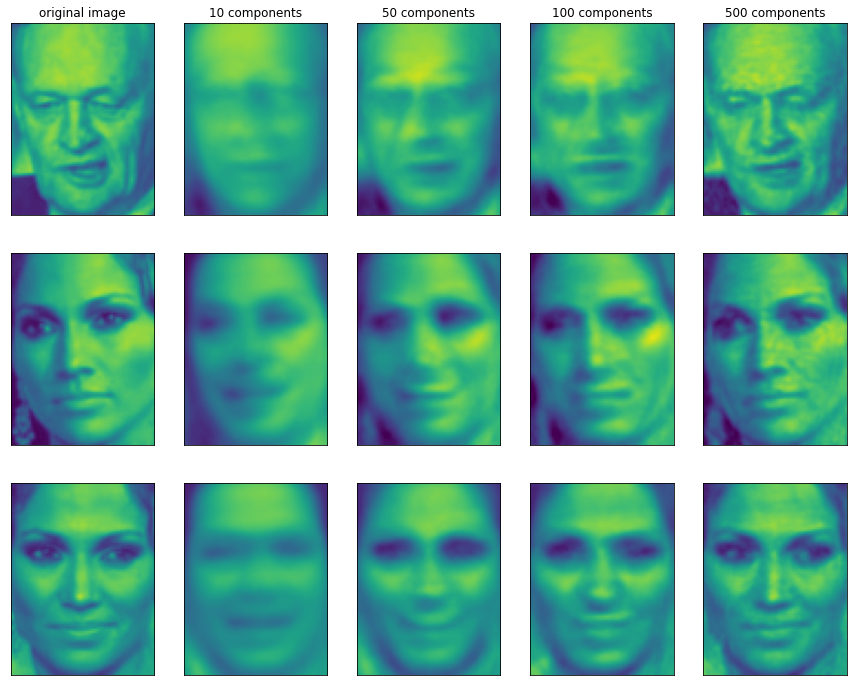

In [34]:
# PCAはテストデータポイントを主成分の重み付き和として表現する、一連の数字(PCAで回転後の新しい特徴量)を見つける手法。と解釈できる
# 詳しくはP.150へ
# 顔画像を10、50、、個の主成分を用いて再構成する
mglearn.plots.plot_pca_faces(X_train, X_test, image_shape)

Text(0, 0.5, 'Second principal component')

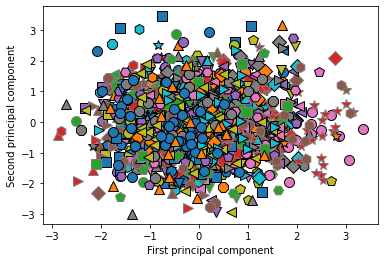

In [35]:
# cancer データセットと同様にPCAを用いて全ての顔を2つの主成分だけを使って散布図を作成
mglearn.discrete_scatter(X_train_pca[:, 0], X_train_pca[:, 1], y_train)
plt.xlabel("First principal component")
plt.ylabel("Second principal component")
# 2つじゃ全く分離できそうにない。上の画像でも10この主成分でも粗い特徴しか捉えられないから分離も難しい。

## 非負値行列因子分解(Non-negatice matrix factorizetion: NMF)
有用な特徴量を抽出することを目的。NMFは係数と成分が非負であること、ゼロ以上であることが求められる。つまり、個々の特徴量がが非負のデータにしか適さない。

データを非負の重み付き和に分解する方法は、いくつかの独立した発生源から得られたデータを重ね合わせて作られるようなデータに対して有効。

例: 複数の人が話す音声データ、音楽など

NMFを用いると、組み合わされたデータの成分を特定できる。まとめると、PCAよりも理解しやすい成分に分解できる。
非負の成分や係数があるとお互いを打ち消してしまい理解しづらい挙動となるが、それがないから。

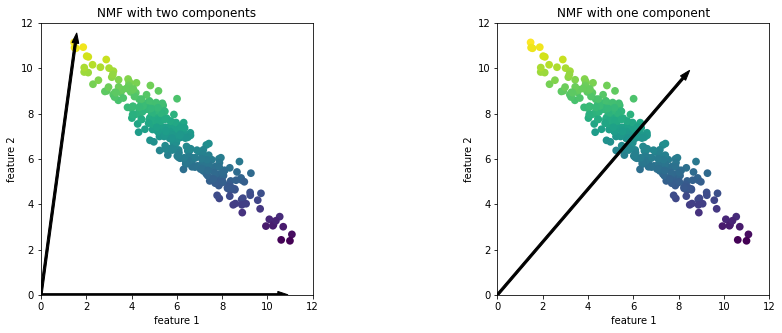

In [36]:
# 合成セットでNMFを試す
# NMFが扱えるように、データが全て正であるようにする。これは原点に対してどの位置にあるかが、NMFでは問題になるから。→非負の成分は原点からデータへの方向と考えられる。
mglearn.plots.plot_nmf_illustration()
# 矢印が成分。左では、２つの矢印の正係数の重み付き和で全てのデータが表現できる。
# PCAと違って、成分は特定な順番で並んではいない(重要度でソートされてはいない)。全ての成分が同等。

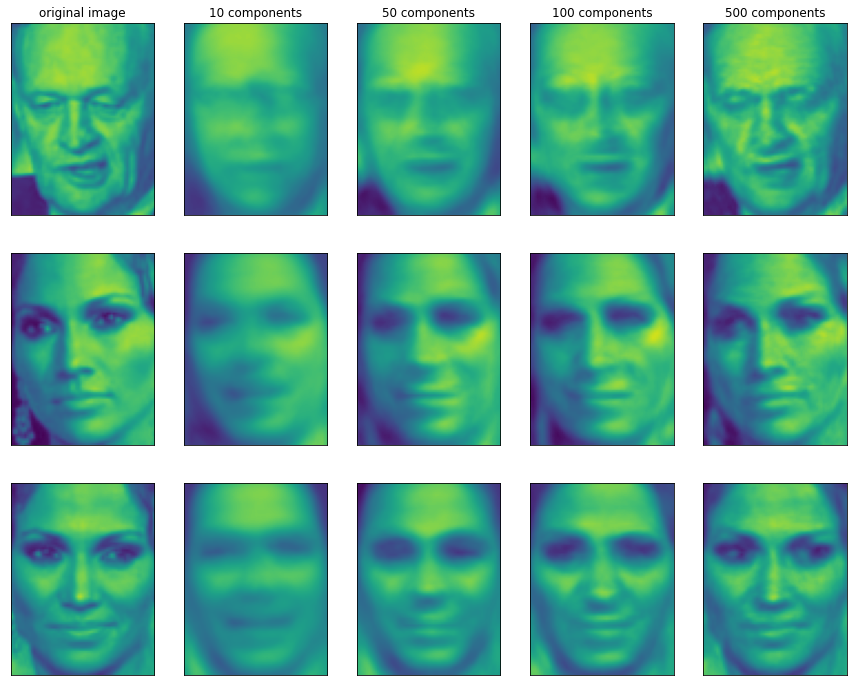

In [37]:
# 顔画像へ適用
# NMFから再構成したデータを見てみる
mglearn.plots.plot_nmf_faces(X_train, X_test, image_shape)
# NMFはデータの中から興味深いパターンを見つけるのに用いられる

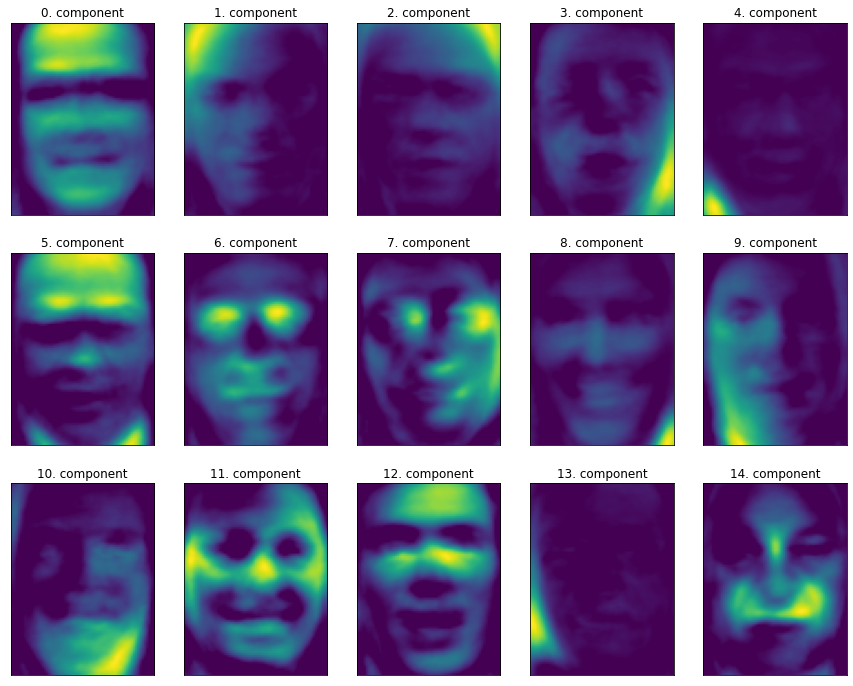

In [38]:
# 最初の15成分を見てみる
from sklearn.decomposition import NMF
nmf = NMF(n_components=15, random_state=0)
nmf.fit(X_train)
X_train_nmf = nmf.transform(X_train)
X_test_nmf = nmf.transform(X_test)

fix, axes = plt.subplots(3, 5, figsize=(15,12), subplot_kw={'xticks': (), 'yticks': ()})
# subplots_kw: https://chihay.hatenablog.com/entry/2018/09/30/224520
for i, (component, ax) in enumerate(zip(nmf.components_, axes.ravel())):
    ax.imshow(component.reshape(image_shape))
    ax.set_title("{}. component".format(i))

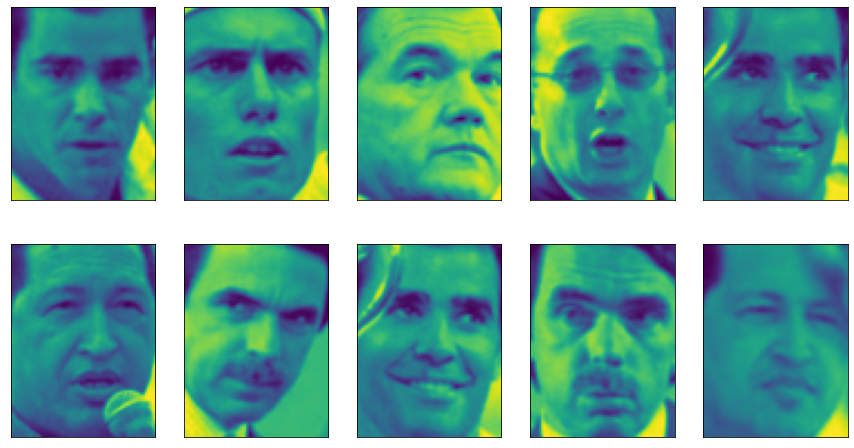

In [39]:
# 成分3でソート、最初の10画像を表示
compn = 3
# [::-1]で逆順にソート 変換された訓練データから成分３について大きい順でソートしてindexを取り出す
inds = np.argsort(X_train_nmf[:, compn])[::-1]
fig, axes = plt.subplots(2, 5, figsize=(15, 8), subplot_kw={'xticks': (), 'yticks': ()})
for i, (ind, ax) in enumerate(zip(inds, axes.ravel())):
    ax.imshow(X_train[ind].reshape(image_shape))
# 3の成分に似た画像が取り出せる

In [40]:
X_train_nmf[:,3]

array([0.21315801, 0.15262502, 0.06032494, ..., 0.0688768 , 0.06834579,
       0.27945292], dtype=float32)

In [41]:
X_train_nmf.shape

(1547, 15)

In [42]:
inds
# 947が一番3の成分が強く出てる(?)

array([ 947, 1245,  737, ...,  414,  682, 1202])

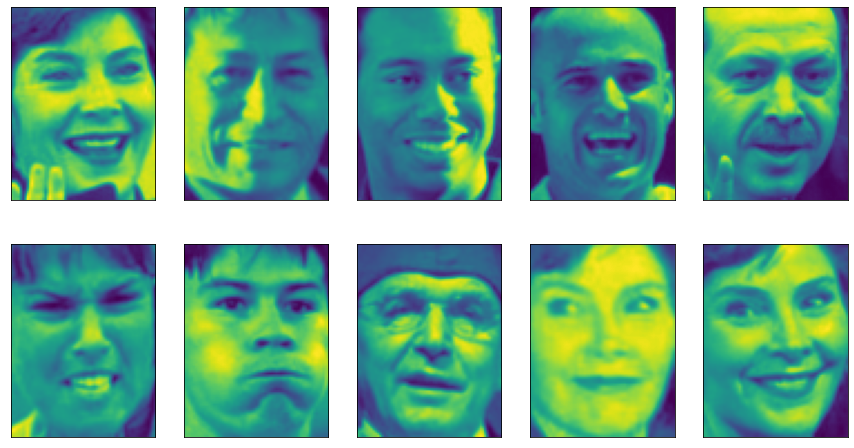

In [43]:
compn = 11
# [::-1]で逆順にソート
inds = np.argsort(X_train_nmf[:, compn])[::-1]
fig, axes = plt.subplots(2, 5, figsize=(15, 8), subplot_kw={'xticks': (), 'yticks': ()})
for i, (ind, ax) in enumerate(zip(inds, axes.ravel())):
    ax.imshow(X_train[ind].reshape(image_shape))

In [44]:
# 新しいデータを使ってknn
knn = KNeighborsClassifier(n_neighbors=1).fit(X_train_nmf, y_train)
print("Test set accuracy: {:.2f}".format(knn.score(X_test_nmf, y_test)))

Test set accuracy: 0.17


Text(0, 0.5, 'Signal')

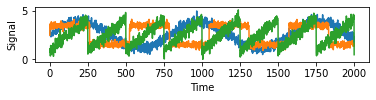

In [45]:
# 3つの信号から組み合わされた波形 sin 方形 ノコギリ
S = mglearn.datasets.make_signals()
plt.figure(figsize=(6, 1))
plt.plot(S, '-')
plt.xlabel("Time")
plt.ylabel("Signal")

In [46]:
S.shape

(2000, 3)

In [47]:
# 3つ合わさったものだけが観測できるとして、混ざった信号を分解して元の成分を取り出す
# 100の計測機器を仮定
# データを混ぜて100次元の状態を作る
A = np.random.RandomState(0).uniform(size=(100, 3))
# Aを転置して内積を求めてる
X = np.dot(S, A.T)
print("Shape of measurments: {}".format(X.shape))
# 100回分信号、合成信号を測定している事になる

Shape of measurments: (2000, 100)


In [48]:
# NMFを用いて復元してみる
nmf = NMF(n_components=3, random_state=42)
S_ = nmf.fit_transform(X)
print("Recovoerd signal shale: {}".format(S_.shape))

Recovoerd signal shale: (2000, 3)


In [49]:
# PCA
pca = PCA(n_components=3)
H = pca.fit_transform(X)

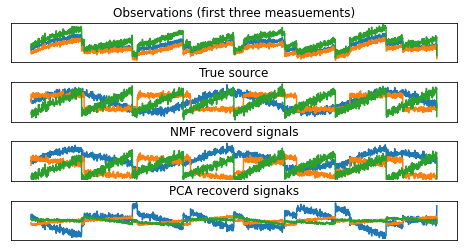

In [50]:
# 可視化
models = [X, S, S_, H]
names= ['Observations (first three measuements)',
        'True source',
        'NMF recoverd signals',
        'PCA recoverd signaks']

fig, axes = plt.subplots(4, figsize=(8, 4), gridspec_kw={'hspace': .5}, subplot_kw={'xticks': (), 'yticks': ()})
for model, name, ax in zip(models, names, axes):
    ax.set_title(name)
    ax.plot(model[:, :3], '-')

NMFやPCAのように、個々のデータポイントを固定数の成分集合の重み付き和に分解するのに利用できるアルゴリズムはまだまだたくさんある
詳しくはsklearnのユーザーページへ

# t-SNEを用いた多様体学習 P.160

データを変換して散布図で可視化したいときはPCAを使うのは悪くないが、手法の性質上、有用性は限られる。顔画像でPCAを試した通り、あまり有用な結果は得られない。

多様体学習アルゴリズム(manifold learning algorithms)と呼ばれる一連のアルゴリズムがある。これらのアルゴリズムは、複雑なマッピングを行うことでより良い可視化を実現できる。

主に可視化に用いられ、ほとんどの場合3以上の新しい特徴量を生成することはない。さらに一部のアルゴリズム(t-SNE含む)は訓練データの新たな表現を計算するが、新しいデータを変換することはできない。つまり、テストセットにこれらのアルゴリズムを適用することはできない→ほぼ可視化専用

探索的なデータ解析に有用だが、最終的な目標が教師あり学習の場合にはほとんど用いることができない。


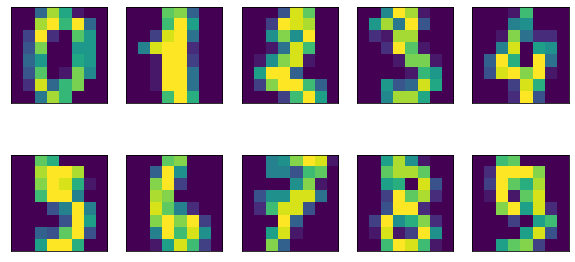

In [51]:
# t-SNEを手書き数字データセットに適用してみる
# まずは画像を見てみる
from sklearn.datasets import load_digits
digits = load_digits()

fig, axes = plt.subplots(2, 5, figsize=(10, 5), subplot_kw={'xticks': (), 'yticks': ()})
for ax, img in zip(axes.ravel(), digits.images):
    ax.imshow(img)

In [52]:
print("images.shape: {}".format(digits.images.shape))
print("images.shape: {}".format(digits.data.shape))

images.shape: (1797, 8, 8)
images.shape: (1797, 64)


Text(0, 0.5, 'Second principal component')

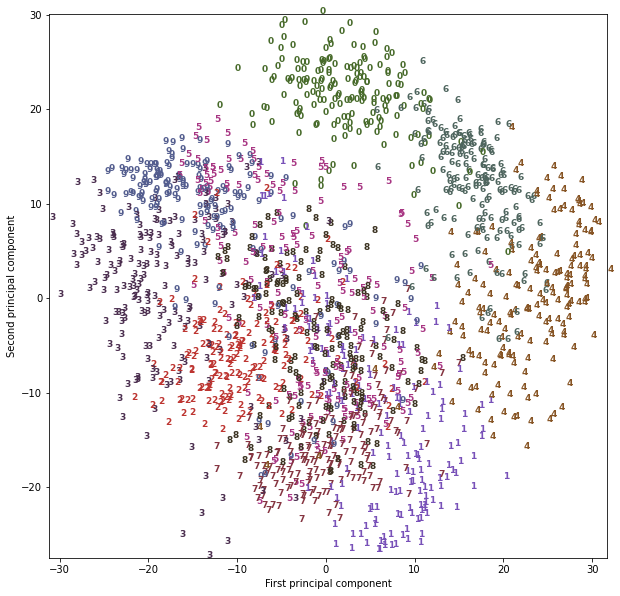

In [53]:
# PCAを使ってこのデータを2次元にして表現してみる
pca = PCA(n_components=2)
pca.fit(digits.data)
# 数値データを最初の2主成分で変形
digits_pca = pca.transform(digits.data)
# 0, 1, 2, 3, 4, 5, 6, 7, 8, 9
colors = ["#476A2A", "#7851B8", "#BD3430", "#4A2D4E", "#875525", "#A83683", "#4E655E", "#853541", "#3A3120", "#535D8E"]
plt.figure(figsize=(10, 10))
plt.xlim(digits_pca[:, 0].min(), digits_pca[:, 0].max())
plt.ylim(digits_pca[:, 1].min(), digits_pca[:, 1].max())
for i in range(len(digits.data)):
    # 散布図を数字でプロット
    plt.text(digits_pca[i, 0], digits_pca[i, 1], str(digits.target[i]),
             color=colors[digits.target[i]], fontdict={'weight': 'bold', 'size': 9})
plt.xlabel("First principal component")
plt.ylabel("Second principal component")
# 0 4 6は2主成分でうまく分離できているが、重なりが大きい。→微妙

In [54]:
# 同じデータセットに対してt-SNEを適用してみる
# 新しいデータの変換をサポートしないため、transformの代わりにfit_transformを使う
from sklearn.manifold import TSNE
tsne = TSNE(random_state=42)
digits_tsne = tsne.fit_transform(digits.data)

Text(0, 0.5, 'Second principal component')

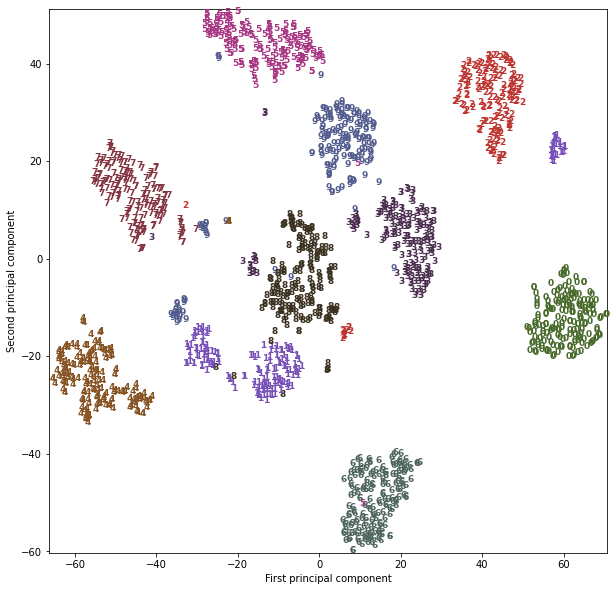

In [55]:
plt.figure(figsize=(10, 10))
plt.xlim(digits_tsne[:, 0].min(), digits_tsne[:, 0].max() + 1)
plt.ylim(digits_tsne[:, 1].min(), digits_tsne[:, 1].max() + 1)
for i in range(len(digits.data)):
    # 散布図を数字でプロット
    plt.text(digits_tsne[i, 0], digits_tsne[i, 1], str(digits.target[i]),
             color=colors[digits.target[i]], fontdict={'weight': 'bold', 'size': 9})
plt.xlabel("First principal component")
plt.ylabel("Second principal component")
# ラベルを一切使わずにほとんど分離できている！
# チューニングパラメータがいくつかあるが、デフォルトの設定で大抵うまくいく(perplexity, early_exaggerationなど)

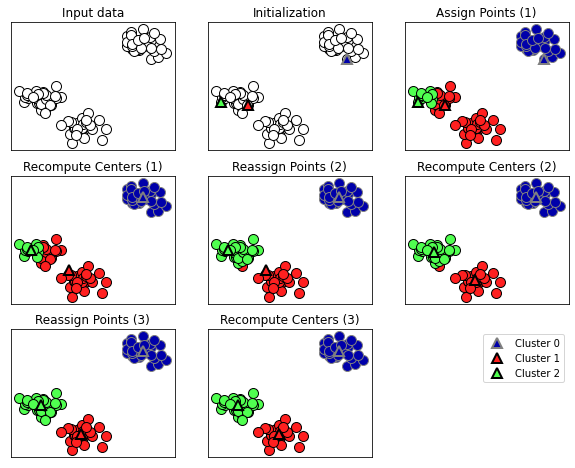

In [56]:
# クラスタリング
mglearn.plots.plot_kmeans_algorithm()

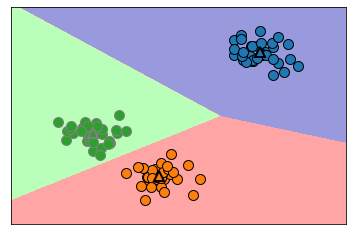

In [57]:
mglearn.plots.plot_kmeans_boundaries()

In [58]:
# k-meansを使ってクラスタリングをする
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans

# 合成2次元データの作成
X, y = make_blobs(random_state=1)

# クラスタリングモデルを作成
kmeans = KMeans(n_clusters=3)
kmeans.fit(X)

KMeans(n_clusters=3)

In [59]:
# fit()で個々のデータポイントに対してクラスタラベルが割り当てられる。
# 割り当てられたラベルはkmeans.labels_で確認できる
print("Cluster membershios:\n{}".format(kmeans.labels_))

Cluster membershios:
[1 0 0 0 2 2 2 0 1 1 0 0 2 1 2 2 2 1 0 0 2 0 2 1 0 2 2 1 1 2 1 1 2 1 0 2 0
 0 0 2 2 0 1 0 0 2 1 1 1 1 0 2 2 2 1 2 0 0 1 1 0 2 2 0 0 2 1 2 1 0 0 0 2 1
 1 0 2 2 1 0 1 0 0 2 1 1 1 1 0 1 2 1 1 0 0 2 2 1 2 1]


In [60]:
# predictメソッドを訓練セットに利用するとlabels_と同じ結果になる
print(kmeans.predict(X))

[1 0 0 0 2 2 2 0 1 1 0 0 2 1 2 2 2 1 0 0 2 0 2 1 0 2 2 1 1 2 1 1 2 1 0 2 0
 0 0 2 2 0 1 0 0 2 1 1 1 1 0 2 2 2 1 2 0 0 1 1 0 2 2 0 0 2 1 2 1 0 0 0 2 1
 1 0 2 2 1 0 1 0 0 2 1 1 1 1 0 1 2 1 1 0 0 2 2 1 2 1]


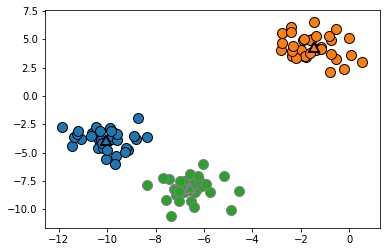

In [61]:
# データをもう一度プロットしてみる
# クラスタセンタはcluster_centers_属性に格納されている
mglearn.discrete_scatter(X[:, 0], X[:, 1], kmeans.labels_, markers='o')
mglearn.discrete_scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], [0, 1, 2], markers='^', markeredgewidth=2)

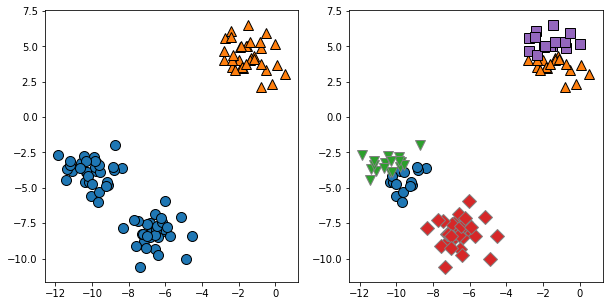

In [62]:
# クラスタセンタの数を変えてみる
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# クラスタセンタを2つに指定
kmeans = KMeans(n_clusters=2).fit(X)
assignments = kmeans.labels_

mglearn.discrete_scatter(X[:, 0], X[:, 1], assignments, ax=axes[0])

# クラスタセンタを5つに指定
kmeans = KMeans(n_clusters=5).fit(X)
assignments = kmeans.labels_

mglearn.discrete_scatter(X[:, 0], X[:, 1], assignments, ax=axes[1])

Text(0, 0.5, 'Feature 1')

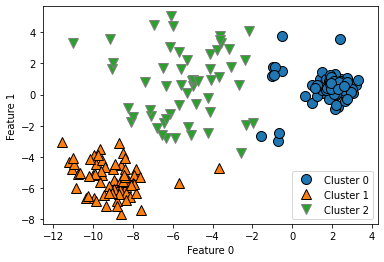

In [63]:
# k-meansでは、うまくクラスタを見つけられるとは限らない。また、単純な形でしかクラスタリングができない
X_varied, y_varied = make_blobs(n_samples=200, cluster_std=[1.0, 2.5, 0.5], random_state=170)
y_pred = KMeans(n_clusters=3, random_state=0).fit_predict(X_varied)

mglearn.discrete_scatter(X_varied[:, 0], X_varied[:, 1], y_pred)
plt.legend(["Cluster 0", "Cluster 1", "Cluster 2"], loc='best')
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

Text(0, 0.5, 'Feature 1')

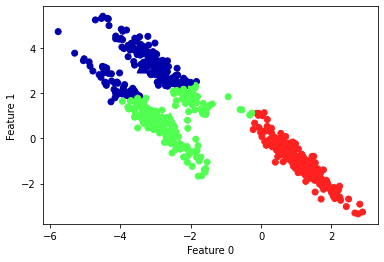

In [64]:
# k-meansはクラスタに関して全ての方向が同じように重要であると仮定している
X, y = make_blobs(random_state=170, n_samples=600)
rng = np.random.RandomState(74)

# 対角線方向に引き伸ばす
# 2*2サイズの正規分布(normal)を作って内積(dot)をとってるらしい？
transformation = rng.normal(size=(2, 2))
X = np.dot(X, transformation)

# 3つにクラスタリング
kmeans = KMeans(n_clusters=3).fit(X)
y_pred = kmeans.predict(X)

# プロット
plt.scatter(X[:, 0], X[:, 1], c=y_pred, cmap=mglearn.cm3)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], marker='^', c=[0, 1, 2], s=100, linewidth=2, cmap=mglearn.cm3)
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

Text(0, 0.5, 'Feature 1')

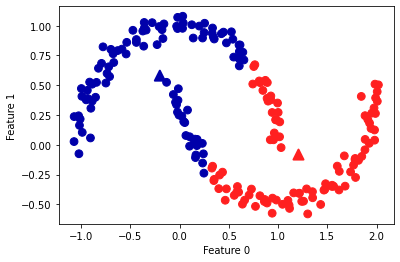

In [65]:
# 複雑な形にもうまく機能しない two_moonsデータセットで試してみる
from sklearn.datasets import make_moons
X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

kmeans = KMeans(n_clusters=2).fit(X)
y_pred = kmeans.predict(X)

plt.scatter(X[:, 0], X[:, 1], c=y_pred, cmap=mglearn.cm2, s=60)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], marker='^', c=[mglearn.cm2(0), mglearn.cm2(1)], s=100, linewidth=2)
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

In [66]:
# k-meansはクラスタセンタで個々のデータポイントを表現。この単一成分でデータポイントを表現する成分分解手法としてみる考え方をベクトル量子化と呼ぶ。
# PCA, NMFとk-meansを、抽出された成分で比較し、再構成画像も比較
X_train, X_test, y_train, y_test = train_test_split(X_people, y_people, stratify=y_people, random_state=0)
nmf = NMF(n_components=100, random_state=0)
nmf.fit(X_train)
pca = PCA(n_components=100, random_state=0)
pca.fit(X_train)
kmeans = KMeans(n_clusters=100, random_state=0)
kmeans.fit(X_train)

X_reconstructed_pca = pca.inverse_transform(pca.transform(X_test))
X_reconstructed_kmeans = kmeans.cluster_centers_[kmeans.predict(X_test)]
X_reconstructed_nmf = np.dot(nmf.transform(X_test), nmf.components_)

Text(0, 0.5, 'nmf')

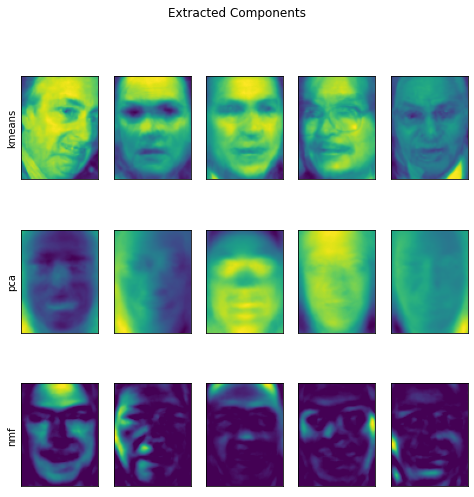

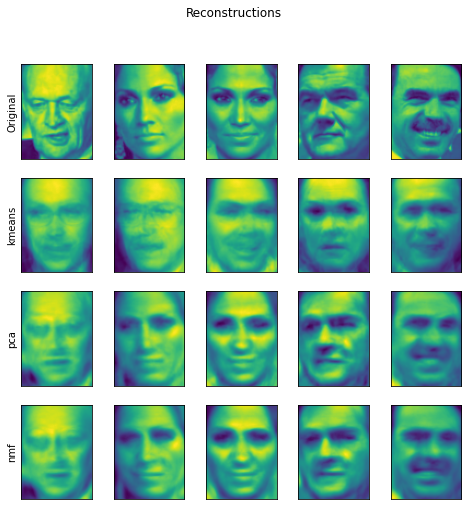

In [67]:
fig, axes = plt.subplots(3, 5, figsize=(8, 8), subplot_kw={'xticks': (), 'yticks': ()})
fig.suptitle("Extracted Components")
for ax, comp_kmeans, comp_pca, comp_nmf in zip(axes.T, kmeans.cluster_centers_, pca.components_, nmf.components_):
    ax[0].imshow(comp_kmeans.reshape(image_shape))
    ax[1].imshow(comp_pca.reshape(image_shape))
    ax[2].imshow(comp_nmf.reshape(image_shape))

axes[0, 0].set_ylabel("kmeans")
axes[1, 0].set_ylabel("pca")
axes[2, 0].set_ylabel("nmf")

fig, axes = plt.subplots(4, 5, subplot_kw={'xticks': (), 'yticks': ()}, figsize=(8, 8))
fig.suptitle("Reconstructions")
for ax, orig, rec_kmeans, rec_pca, rec_nmf in zip(
    axes.T, X_test, X_reconstructed_kmeans, X_reconstructed_pca, X_reconstructed_nmf):

    ax[0].imshow(orig.reshape(image_shape))
    ax[1].imshow(rec_kmeans.reshape(image_shape))
    ax[2].imshow(rec_pca.reshape(image_shape))
    ax[3].imshow(rec_nmf.reshape(image_shape))

axes[0, 0].set_ylabel("Original")
axes[1, 0].set_ylabel("kmeans")
axes[2, 0].set_ylabel("pca")
axes[3, 0].set_ylabel("nmf")

Cluster memberships:
[4 7 6 9 7 7 4 1 4 1 8 3 7 1 0 4 2 3 2 0 5 1 2 1 8 6 7 5 6 2 4 8 1 6 4 5 3
 4 0 6 3 8 2 6 7 8 4 0 6 1 0 3 5 9 1 4 2 1 2 8 3 9 7 4 1 9 8 7 8 9 3 9 3 6
 1 9 6 4 2 3 5 8 3 5 6 8 4 8 3 5 2 4 5 0 5 7 7 3 9 6 1 5 8 4 9 6 9 8 7 2 0
 8 8 9 4 1 2 5 3 4 4 0 6 8 6 0 4 6 1 5 4 0 9 3 1 7 1 9 5 4 6 6 2 8 8 4 6 1
 2 6 3 7 4 2 3 8 1 3 2 2 6 1 2 7 3 7 2 3 7 1 2 9 0 0 6 1 5 0 0 2 7 0 5 7 5
 2 8 3 9 0 9 2 4 4 6 0 5 6 2 7]


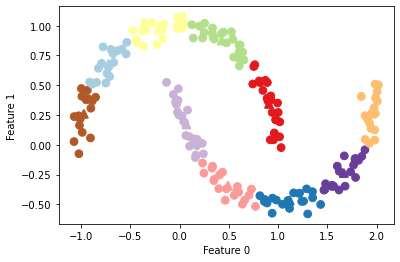

In [68]:
# 多数のクラスタセンタでk-meansを用いると強力な表現が見つけられる
X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

kmeans = KMeans(n_clusters=10, random_state=0)
kmeans.fit(X)
y_pred = kmeans.predict(X)

plt.scatter(X[:, 0], X[:, 1], c=y_pred, s=60, cmap='Paired')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=60, marker='^', c=range(kmeans.n_clusters), linewidth=2, cmap='Paired')
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")
print("Cluster memberships:\n{}".format(y_pred))
# これを10成分でのデータ表現であると考えられる。クラスタセンタに相当する特徴量だけ1で、それ以外が0とするデータ表現。→10の特徴量ができてる
# さらに、個々のクラスタセンタからの距離を特徴量とすれば、さらに強力な表現となる。→transformを用いる

In [69]:
distance_features = kmeans.transform(X)
print("Distance feature shape: {}".format(distance_features.shape))
print("Distance features:\n{}".format(distance_features))

Distance feature shape: (200, 10)
Distance features:
[[1.54731274 1.03376805 0.52485524 ... 1.14060718 1.12484411 1.80791793]
 [2.56907679 0.50806038 1.72923085 ... 0.149581   2.27569325 2.66814112]
 [0.80949799 1.35912551 0.7503402  ... 1.76451208 0.71910707 0.95077955]
 ...
 [1.12985081 1.04864197 0.91717872 ... 1.50934512 1.04915948 1.17816482]
 [0.90881164 1.77871545 0.33200664 ... 1.98349977 0.34346911 1.32756232]
 [2.51141196 0.55940949 1.62142259 ... 0.04819401 2.189235   2.63792601]]


# k-means

- 非常に広く用いられているクラスタリングアルゴリズム
- 理解しやすい、実装しやすい、高速

## 欠点

- 初期化が乱数で行われるため、出力が乱数に依存する
- クラスタの形に対して制約の強い仮定をおいている
- 探しているクラスタの数をユーザが指定しなければならない
  →実際にはクラスタの数はわからないことが多い

次は、これらの特性を改良したクラスタリングアルゴリズムを2つ見てみる

# 凝集型クラスタリング: Agglomeerative clustering

個々のデータポイントをそれぞれ個別のクラスタとして開始し、最も類似したクラスタを併合していく。
これを何らかの終了条件が満たされるまで繰り返す。
scikit-learnに実装されている終了条件がクラスタの数となる。つまり、指定した数のクラスタが残るまで、似たクラスタを併合していく。
最も類似したクラスタを決定する連結度(linkage)には様々なものがある。この連結度は常に2つの既存クラスタ間で定義される。

scikit-learnには次の3つが実装されている

- ward
  デフォルト。併合した際にクラスタ内の分散の増分が最小になるようにクラスタを選択

- average
  クラスタ間の全てのポイント間の距離の平均値が最小の2クラスタを併合

- complete
  2つのクラスタの転換の距離の最大値が最小となるものを併合する

wardではほとんどのデータセットでうまくいく。クラスタによってデータポイントの数が極端に違う場合、他二つの方がうまくいくかも

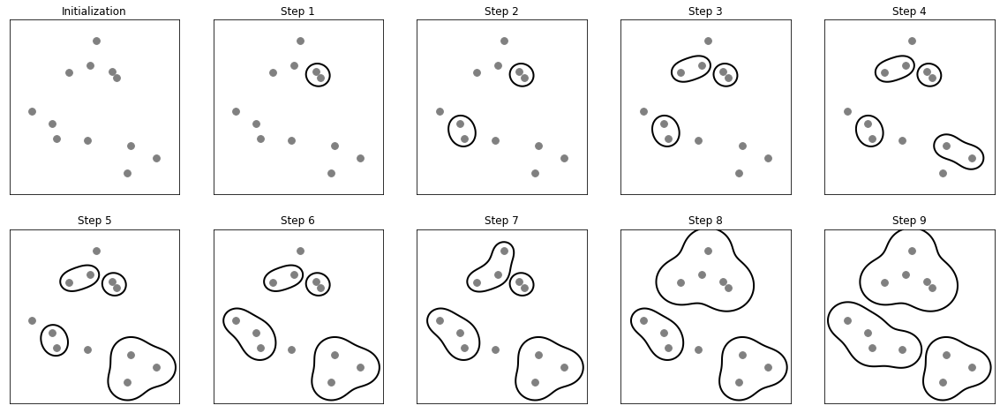

In [70]:
# 凝集型クラスタリングの進行過程
mglearn.plots.plot_agglomerative_algorithm()

Text(0, 0.5, 'Feature 1')

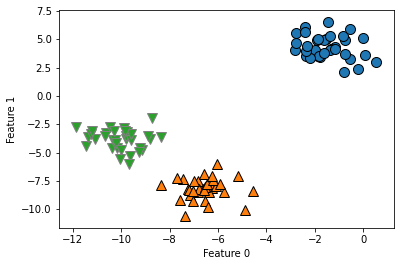

In [71]:
# 凝集型クラスタリングは新しいデータに対して予測できたいため、fit_predictを用いて訓練セットに対するクラスタをえる
from sklearn.cluster import AgglomerativeClustering
X, y = make_blobs(random_state=1)

agg = AgglomerativeClustering(n_clusters=3)
assignment = agg.fit_predict(X)

mglearn.discrete_scatter(X[:, 0], X[:, 1], assignment)
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

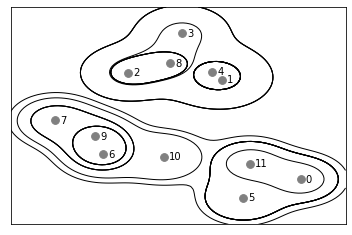

In [72]:
# 凝集型クラスタリングを行うと、いわゆる階層型クラスタリングが行われている。クラスタリングを重ねて表示
mglearn.plots.plot_agglomerative()

Text(0, 0.5, 'Cluster distance')

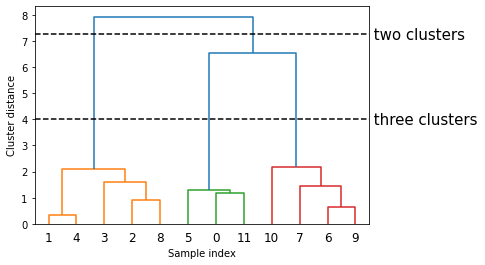

In [73]:
# この可視化は、データが2次元であることに依存している。階層型クラスタリングの可視化には、デンドログラムという方法がある。この方法では、多次元のデータセットを扱うことができる
# SciPyを使うことでデンドログラムを描画。詳しくはP.180
# scipyからデンドログラム関数とwardクラスタリング関数をインポート
from scipy.cluster.hierarchy import dendrogram, ward

X, y = make_blobs(random_state=0, n_samples=12)
# wardクラスタリングをデータ配列Xに適用
# SciPyのward関数は、凝集型クラスタリングを行った際のブリッジ距離を示す配列(クラスタの類似度)を返す
linkage_array = ward(X)
# このlinkage_arrayに書かれたクラスタ間距離をデンドログラムとしてプロットする
dendrogram(linkage_array)

# 2クラスタと3クラスタの部分での切断を表示
ax = plt.gca()
bounds = ax.get_xbound()
ax.plot(bounds, [7.25, 7.25], '--', c='k')
ax.plot(bounds, [4, 4], '--', c='k')

ax.text(bounds[1], 7.25, ' two clusters', va='center', fontdict={'size': 15})
ax.text(bounds[1], 4, ' three clusters', va='center', fontdict={'size': 15})
plt.xlabel("Sample index")
plt.ylabel("Cluster distance")
# 凝集型クラスタリングでもtwo_moonsのような複雑な形はうまく扱えない・・・が、DBSCANなら話が違う

# DBSCAN: Density Based Spatial Clustering of Applications with Noise

密度に基づくノイズあり空間クラスタリング

- ユーザがクラスタ数を先験的に与える必要がない

- どのクラスタにも属さない点を判別できる

- 凝集型クラスタリング、k-meansよりも遅いが、比較的大きいデータセットにも対応できる

## パラメータ

- eps

    同じクラスタと見なす距離

- min_samples

    eps内にあるデータをクラスタと見なす最小のデータサンプル数

DBSCANではStandardScalerやMinMaxScalerでスケール変換を行ってからepsを調整すると良い

詳しくはP.182

In [74]:
# 合成データセットにDBSCANを適用してみる
# 新しいテストデータには予測できないため、fit_predictメソッドを用いる(凝集型クラスタリングと一緒)

from sklearn.cluster import DBSCAN
X, y = make_blobs(random_state=0, n_samples=12)

dbscan = DBSCAN()
clusters = dbscan.fit_predict(X)
print(f"Cluster memberships:\n{clusters}")
# 全てのデータポイントがノイズを表すｰ1となっている。→epsとmin_samplesのデフォルト設定が適していない

Cluster memberships:
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1]


min_samples: 2 eps: 1.000000  cluster: [-1  0  0 -1  0 -1  1  1  0  1 -1 -1]
min_samples: 2 eps: 1.500000  cluster: [0 1 1 1 1 0 2 2 1 2 2 0]
min_samples: 2 eps: 2.000000  cluster: [0 1 1 1 1 0 0 0 1 0 0 0]
min_samples: 2 eps: 3.000000  cluster: [0 0 0 0 0 0 0 0 0 0 0 0]
min_samples: 3 eps: 1.000000  cluster: [-1  0  0 -1  0 -1  1  1  0  1 -1 -1]
min_samples: 3 eps: 1.500000  cluster: [0 1 1 1 1 0 2 2 1 2 2 0]
min_samples: 3 eps: 2.000000  cluster: [0 1 1 1 1 0 0 0 1 0 0 0]
min_samples: 3 eps: 3.000000  cluster: [0 0 0 0 0 0 0 0 0 0 0 0]
min_samples: 5 eps: 1.000000  cluster: [-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1]
min_samples: 5 eps: 1.500000  cluster: [-1  0  0  0  0 -1 -1 -1  0 -1 -1 -1]
min_samples: 5 eps: 2.000000  cluster: [-1  0  0  0  0 -1 -1 -1  0 -1 -1 -1]
min_samples: 5 eps: 3.000000  cluster: [0 0 0 0 0 0 0 0 0 0 0 0]


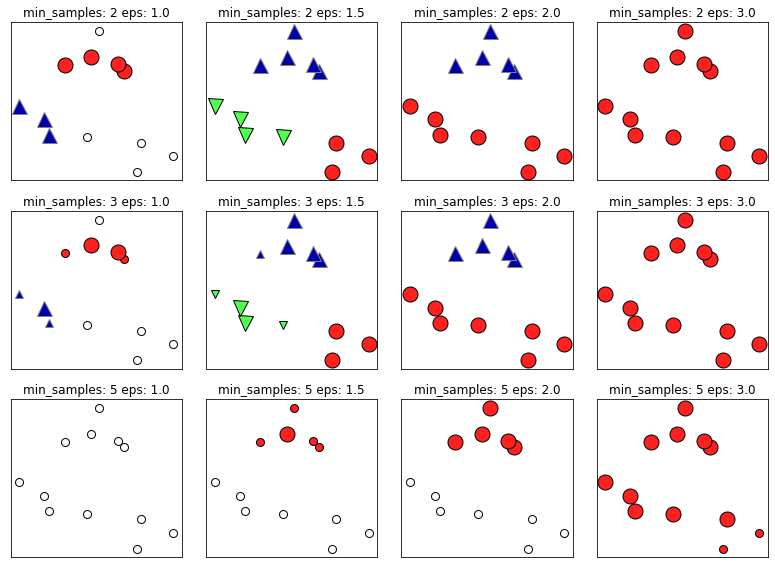

In [75]:
# epsとmin_samplesを様々な値に設定
mglearn.plots.plot_dbscan()

Text(0, 0.5, 'Feature 1')

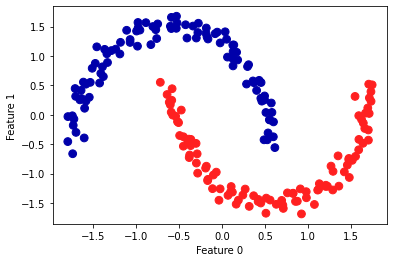

In [76]:
# two_moonsにDBSCANを適用
X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

# データを平均0、分散1に変換
scaler = StandardScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)

dbscan = DBSCAN()
clusters = dbscan.fit_predict(X_scaled)
# クラスタリング結果をプロット
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=clusters, cmap=mglearn.cm2, s=60)
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

# クラスタリングアルゴリズムの比較と評価
クラスタリングアルゴリズムがどの程度うまく機能しているのかを判断し、各アルゴリズムの結果を比較することが難しい

クラスタリングアルゴリズムの出力を正解データクラスタリングと比較して評価するために用いられる指標

- **調整ランド指数: ARI - adjusted rand index**

- **正規化相互情報量: NMI - normalized mutual information**

どちらも定量的な指標で、最良の場合に1を、関係ないクラスタリングの場合に0をとる

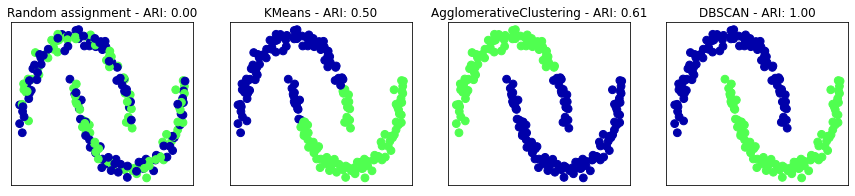

In [77]:
# ARIを各アルゴリズムで比較してみる
from sklearn.metrics.cluster import adjusted_rand_score
X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

# 平均0、分散1に変換
scaler = StandardScaler()
scaler.fit(X)
X_scaled = scaler.transform(X)

fig, axes = plt.subplots(1, 4, figsize=(15, 3), subplot_kw={'xticks': (), 'yticks': ()})

# 利用するアルゴリズムのリストを作る
algorithms = [KMeans(n_clusters=2), AgglomerativeClustering(n_clusters=2), DBSCAN()]

# 参照のためにランダムなクラスタ割り当てを作る
random_state = np.random.RandomState(seed=0)
random_clusters = random_state.randint(low=0, high=2, size=len(X))

# ランダムな割り当てをプロット
axes[0].scatter(X_scaled[:, 0], X_scaled[:, 1], c=random_clusters, cmap=mglearn.cm3, s=60)
axes[0].set_title("Random assignment - ARI: {:.2f}".format(adjusted_rand_score(y, random_clusters)))

for ax, algorithm in zip(axes[1:], algorithms):
    # クラスタ割り当てとクラスタセンタをプロット
    clusters = algorithm.fit_predict(X_scaled)
    ax.scatter(X_scaled[:, 0], X_scaled[:, 1], c=clusters, cmap=mglearn.cm3, s=60)
    ax.set_title(f"{algorithm.__class__.__name__} - ARI: {adjusted_rand_score(y, clusters):.2f}")

In [78]:
# accuracy_scoreを用いてはいけない→割り当てられたクラスタラベルが正解データに完全に一致していることが要求される。が、クラスタラベル自身には意味がない。
from sklearn.metrics import accuracy_score

# 2つのラベルは、同じクラスタリングを表す
clusters1 = [0, 0, 1, 1, 0]
clusters2 = [1, 1, 0, 0, 1]

# 精度は0→ラベルが一致していないため
print("Accuracy: {:.2f}".format(accuracy_score(clusters1, clusters2)))
# ARIスコアは1→クラスタリングが同じだから
print("ARI: {:.2f}".format(adjusted_rand_score(clusters1, clusters2)))

Accuracy: 0.00
ARI: 1.00


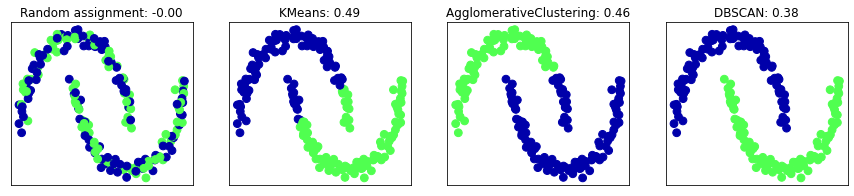

In [79]:
# 実際には正解データがないため、ARIやNMIのような指標はあまり役に立たない。
# 正解データを必要としないシルエット係数という指標がある。が、クラスタのコンパクトさを計算するため、複雑な形状のクラスタはコンパクトにならない
# two-moonsに対するk-means, 凝集型クラスタリング、DBSCANの結果をシルエットスコアで比較
from sklearn.metrics.cluster import silhouette_score

X, y = make_moons(n_samples=200, noise=0.05, random_state=0)

# 平均0、分散0
X_scaled = StandardScaler().fit_transform(X)

fig, axes = plt.subplots(1, 4, figsize=(15, 3), subplot_kw={'xticks': (), 'yticks': ()})

# 参照のためにランダムなクラスタ割り当てを作る
random_state = np.random.RandomState(seed=0)
random_clusters = random_state.randint(low=0, high=2, size=len(X))

# ランダムな割り当てをプロット
axes[0].scatter(X_scaled[:, 0], X_scaled[:, 1], c=random_clusters, cmap=mglearn.cm3, s=60)
axes[0].set_title("Random assignment: {:.2f}".format(silhouette_score(X_scaled, random_clusters)))

for ax, algorithm in zip(axes[1:], algorithms):
    # クラスタ割り当てとクラスタセンタをプロット
    clusters = algorithm.fit_predict(X_scaled)
    ax.scatter(X_scaled[:, 0], X_scaled[:, 1], c=clusters, cmap=mglearn.cm3, s=60)
    ax.set_title(f"{algorithm.__class__.__name__}: {silhouette_score(X_scaled, clusters):.2f}")

# もう少し良い評価方法として、頑健性を用いたクラスタリング評価指標がある。詳しくは→P.189


In [80]:
# PCA(whiten=True)で生成された100成分の固有顔表現を用いて顔画像データセットをクラスタリングしてみる
from sklearn.decomposition import PCA
pca = PCA(n_components=100, whiten=True, random_state=0)
pca.fit_transform(X_people)
X_pca = pca.transform(X_people)
# PCAを用いると、データ表現は生のピクセルよりも意味的な表現になり、計算も早くなる

In [81]:
# DBSCANで解析
dbscan = DBSCAN()
labels = dbscan.fit_predict(X_pca)
print(f"Unique labels: {np.unique(labels)}")
# 全てのデータポイントがノイズと判断されている→epsを大きくするか、min_samplesを小さくして小さいグループをクラスタとする

Unique labels: [-1]


In [82]:
# まずはmin_samplesをいじる
dbscan = DBSCAN(min_samples=3)
labels = dbscan.fit_predict(X_pca)
print(f"Unique labels: {np.unique(labels)}")
# 3点のグループをクラスタとしても、まだ全てがノイズとなっている

Unique labels: [-1]


In [83]:
# epsをいじる
dbscan = DBSCAN(min_samples=3, eps=15)
labels = dbscan.fit_predict(X_pca)
print(f"Unique labels: {np.unique(labels)}")
# 1つのクラスタとノイズだけになった

Unique labels: [-1  0]


In [84]:
# ノイズとクラスタがどれぐらいあるか調べる
# bincount は負の数を許さないため、+1をしておく
# -1 + 1 =0→最初の数がノイズのデータポイント数となる
print(f"Number of points per cluster: {np.bincount(labels + 1)}")

Number of points per cluster: [  32 2031]


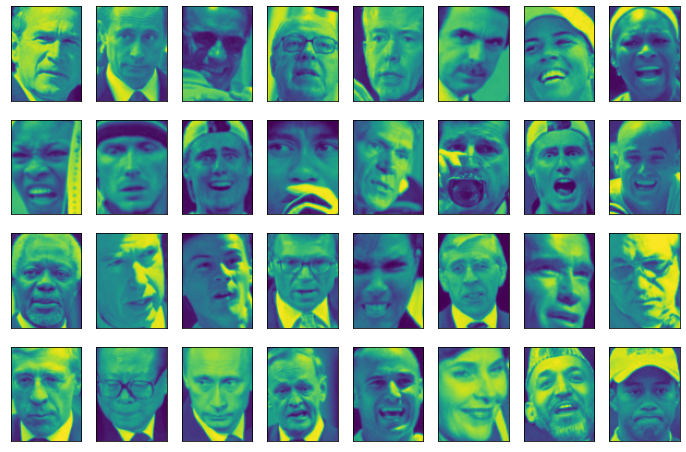

In [85]:
# labels が -1となっているところと同じインデックスの要素を取り出す
noise = X_people[labels == -1]

fig, axes = plt.subplots(4, 8, figsize=(12, 8), subplot_kw={'xticks': (), 'yticks': ()})
for image, ax in zip(noise, axes.ravel()):
    ax.imshow(image.reshape(image_shape), vmin=0, vmax=1)
# 何かおかしなものを見つける解析を外れ値検出と呼ぶ

In [86]:
# epsをもう少し細かく分けて、クラスタを見つけてみる(0.5~15の間で
for eps in [1, 3, 5, 7, 9, 11, 13]:
    print(f"\neps={eps}")
    dbscan = DBSCAN(eps=eps, min_samples=3)
    labels = dbscan.fit_predict(X_pca)
    print(f"Clusters present: {np.unique(labels)}")
    print(f"Cluster sizes: {np.bincount(labels + 1)}")
# 大きいクラスタが1つ以上得られることはない。一番良い場合でも、大きいクラスタにはほとんどのデータポイントが属していて、他には小さいクラスタがいくつかあるだけ
# →全ての顔画像が同じように似ていることを意味している


eps=1
Clusters present: [-1]
Cluster sizes: [2063]

eps=3
Clusters present: [-1]
Cluster sizes: [2063]

eps=5
Clusters present: [-1]
Cluster sizes: [2063]

eps=7
Clusters present: [-1  0  1  2  3  4  5  6  7  8  9 10 11 12]
Cluster sizes: [2004    3   14    7    4    3    3    4    4    3    3    5    3    3]

eps=9
Clusters present: [-1  0  1  2]
Cluster sizes: [1307  750    3    3]

eps=11
Clusters present: [-1  0]
Cluster sizes: [ 413 1650]

eps=13
Clusters present: [-1  0]
Cluster sizes: [ 120 1943]


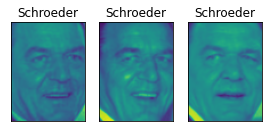

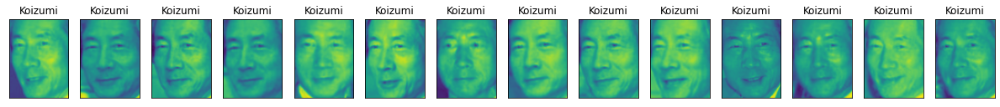

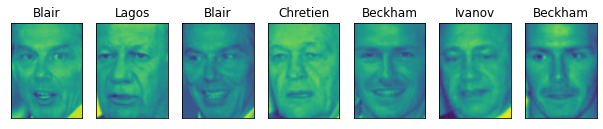

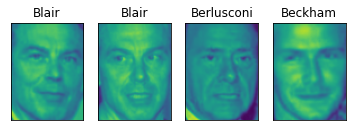

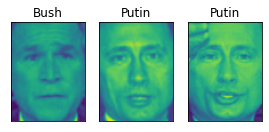

...

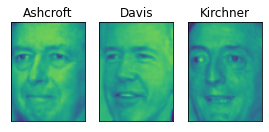

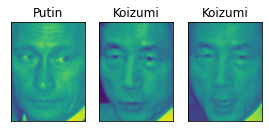

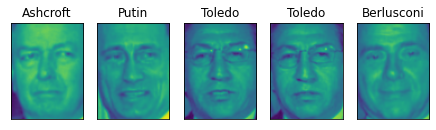

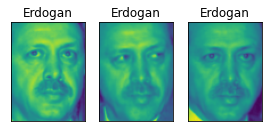

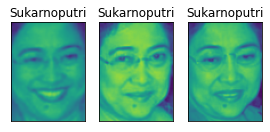

In [87]:
# eps=7の結果からクラスタに属するデータポイントを可視化してみる
dbscan = DBSCAN(min_samples=3, eps=7)
labels = dbscan.fit_predict(X_pca)

#  外れ値以外の0~12までのクラスタを表示したい→range(12+1)
for cluster in range(max(labels) + 1):
    mask = labels == cluster
    # 1クラスタに5(n_images)枚の写真があったら列5のサブプロットを生成
    n_images = np.sum(mask)
    fig, axes = plt.subplots(1, n_images, figsize=(n_images * 1.5, 4), subplot_kw={'xticks': (), 'yticks': ()})
    for image, label, ax in zip(X_people[mask], y_people[mask], axes):
        ax.imshow(image.reshape(image_shape), vmin=0, vmax=1)
        ax.set_title(people.target_names[label].split()[-1])

In [88]:
# k-meansによる解析 10クラスタに分ける
km = KMeans(n_clusters=10, random_state=0)
labels_km = km.fit_predict(X_pca)
print(f"Cluster sizes k-means: {np.bincount(labels_km)}")
# 比較的同じような大きさのクラスタに分割できている

Cluster sizes k-means: [280 226 104 268 152 326 203 208 207  89]


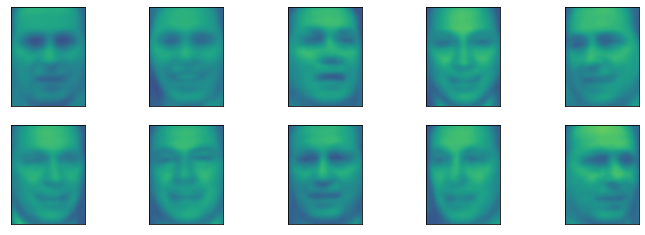

In [89]:
# k-meansの結果を可視化する。pcaでの表現をクラスタリングしたため、逆変換をさせる
fig, axes = plt.subplots(2, 5, figsize=(12, 4), subplot_kw={'xticks': (), 'yticks': ()})
for center, ax in zip(km.cluster_centers_, axes.ravel()):
    ax.imshow(pca.inverse_transform(center).reshape(image_shape), vmin=0, vmax=1)

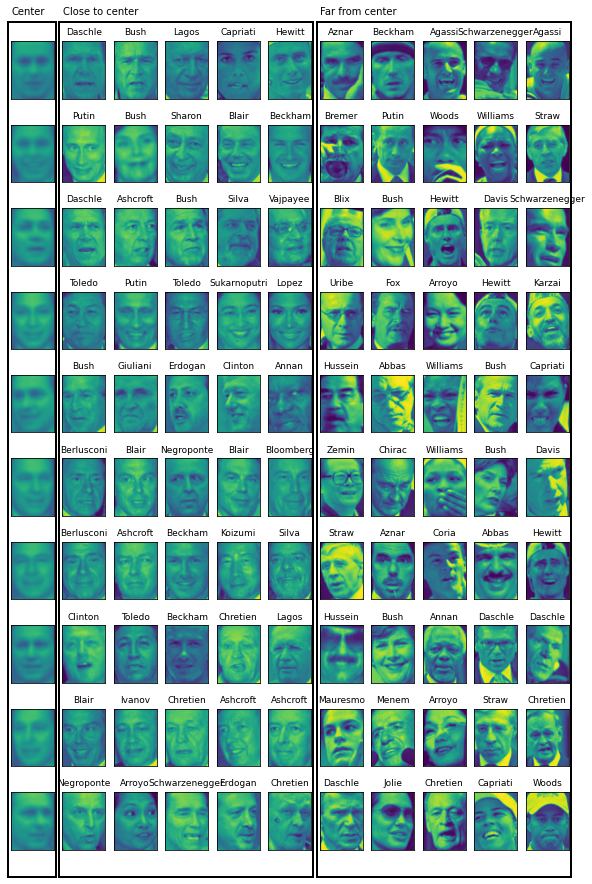

In [90]:
# それぞれのクラスタに対して、典型的な5枚の画像(クラスタセンタから最も近い5枚)と最も典型的でない5枚を表示
mglearn.plots.plot_kmeans_faces(km, pca, X_pca, X_people, y_people, people.target_names)
# ノイズの概念がなく、全てのデータをどこかのクラスタに分割するためにこうなる

In [91]:
# 凝集型クラスタリングによる解析
# ward凝集型
agglomerative = AgglomerativeClustering(n_clusters=10)
labels_agg = agglomerative.fit_predict(X_pca)
print(f"Cluster size agglomerative clustering: {np.bincount(labels_agg)}")
# k-meansほどではないが、均等に分割している

Cluster size agglomerative clustering: [169 660 144 329 217  85  18 261  31 149]


In [92]:
# 凝集型クラスタリングとk-meansの結果の分割が似ているかをARIで測る
print(f"ARI: {adjusted_rand_score(labels_agg, labels_km):.2f}")
# k-meansと凝縮型クラスタリングには共通点がほとんどない

ARI: 0.10


Text(0, 0.5, 'Cluster distance')

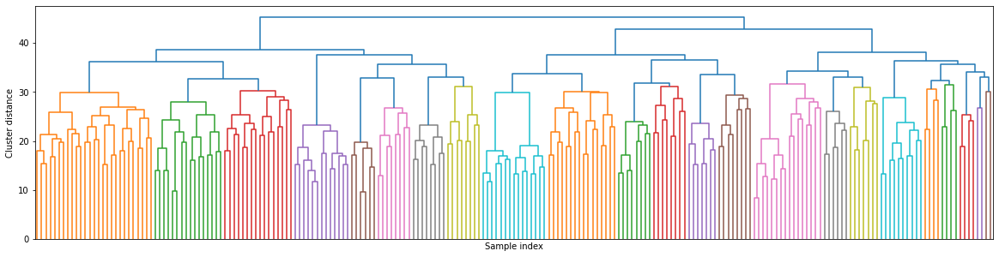

In [93]:
# デンドログラムを描画。描画する深さを制限する
linkage_array = ward(X_pca)
# linkage_arrayに書かれたクラスタ間距離をデンドログラムとしてプロットする
plt.figure(figsize=(20, 5))
dendrogram(linkage_array, p=7, truncate_mode='level', no_labels=True)
plt.xlabel("Sample index")
plt.ylabel("Cluster distance")

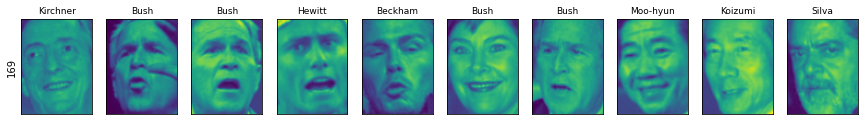

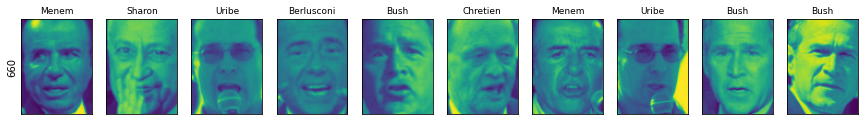

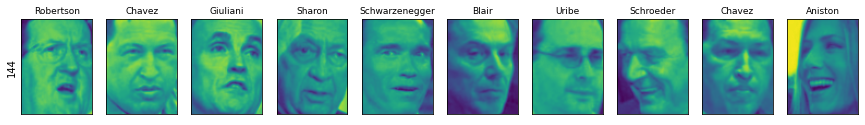

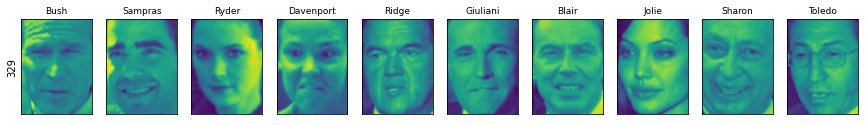

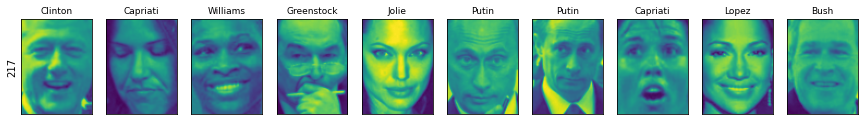

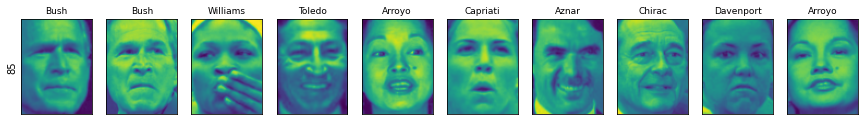

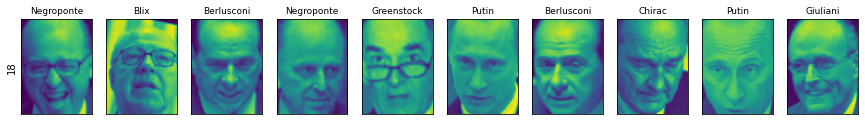

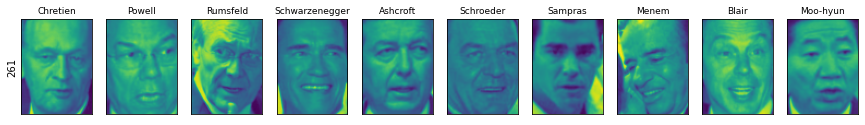

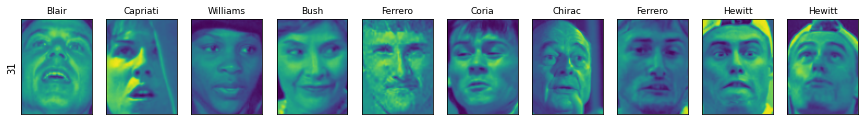

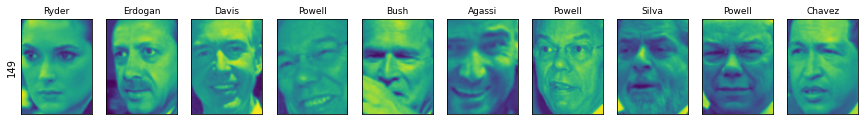

In [94]:
# 10クラスタを可視化してみる。クラスタセンタに相当するものはないため、それぞれのクラスタの最初の数点を示す。一番左にクラスタのサイズを示す
n_clusters = 10
for cluster in range(n_clusters):
    mask = labels_agg == cluster
    fig, axes = plt.subplots(1, 10, figsize=(15, 8), subplot_kw={'xticks': (), 'yticks': ()})
    axes[0].set_ylabel(np.sum(mask))
    for image, label, asdf, ax in zip(X_people[mask], y_people[mask], labels_agg[mask], axes):
        ax.imshow(image.reshape(image_shape), vmin=0, vmax=1)
        ax.set_title(people.target_names[label].split()[-1], fontdict={'fontsize': 9})
# ほとんどのクラスタは均質であるには大きすぎる

Cluster sizes agglomerative clustering: [ 43 120 100 194  56  58 127  22   6  37  65  49  84  18 168  44  47  31
  78  30 166  20  57  14  11  29  23   5   8  84  67  30  57  16  22  12
  29   2  26   8]


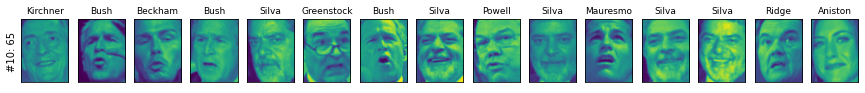

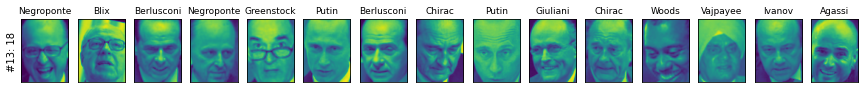

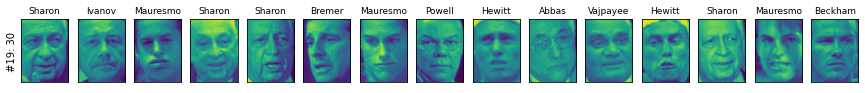

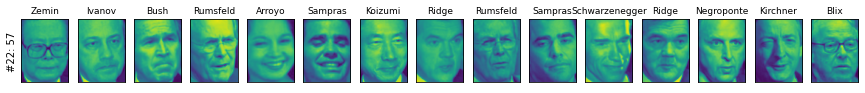

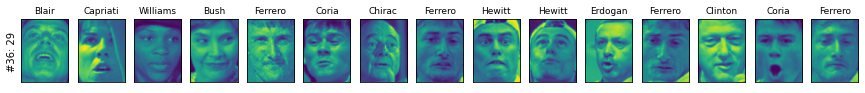

In [95]:
# 40クラスタにして、より均質なクラスタを得てみる
agglomerative = AgglomerativeClustering(n_clusters=40)
labels_agg = agglomerative.fit_predict(X_pca)
print(f"Cluster sizes agglomerative clustering: {np.bincount(labels_agg)}")

n_clusters = 40
for cluster in [10, 13, 19, 22, 36]: # 面白そうなクラスタを選んでる テキストとverが違うため、同じ結果ではない
    mask = labels_agg == cluster
    fig, axes = plt.subplots(1, 15, figsize=(15, 8), subplot_kw={'xticks': (), 'yticks': ()})
    cluster_size = np.sum(mask)
    axes[0].set_ylabel(f"#{cluster}: {cluster_size}")
    for image, label, asdf, ax in zip(X_people[mask], y_people[mask], labels_agg[mask], axes):
        ax.imshow(image.reshape(image_shape), vmin=0, vmax=1)
        ax.set_title(people.target_names[label].split()[-1], fontdict={'fontsize': 9})
    
    # 余白を表示させなくする
    for i in range(cluster_size, 15):
        axes[i].set_visible(False)